In [206]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import sdv
from sdv.evaluation.single_table import evaluate_quality
from sdv.single_table import CTGANSynthesizer
from sdv.single_table import TVAESynthesizer
from sdv.metadata import SingleTableMetadata
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from xgboost import XGBRegressor
from sklearn.pipeline import Pipeline
from sklearn.model_selection import KFold, cross_validate
from sklearn.base import clone
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import LinearRegression
import os
from catboost import CatBoostRegressor
from pytorch_tabnet.tab_model import TabNetRegressor
from sklearn.neural_network import MLPRegressor
import keras
from keras import layers
from keras import models
import seaborn as sns
import matplotlib.pyplot as plt
import scipy.stats

In [207]:
synthetic_data = pd.read_csv("synthetic_data_with_phonetics.csv")
combined_dataset = pd.read_csv("original_data_with_phonetics.csv")

In [208]:
full_data = pd.concat([synthetic_data,
                       combined_dataset],
                       axis=0)

In [209]:
columns_to_analyze = ["nail or object biting",
                      "chapped lips",
                      "increased thirst",
                      "dysphagia",
                      "Stammering",
                      "Jaw Injuries"]

#### Dropping some features

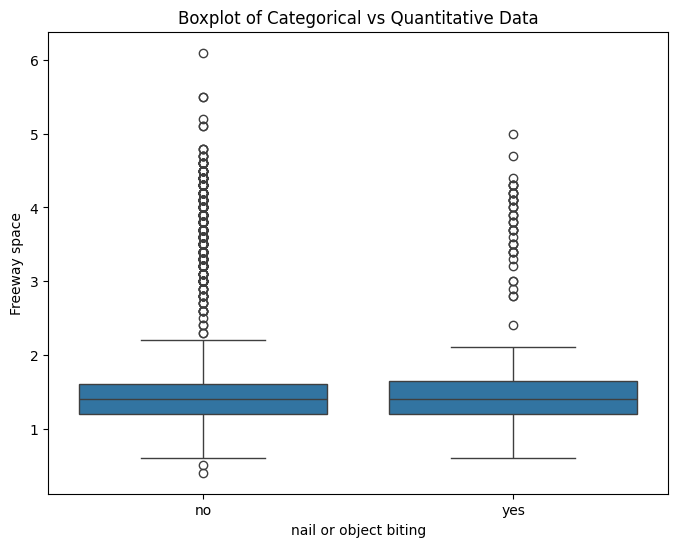

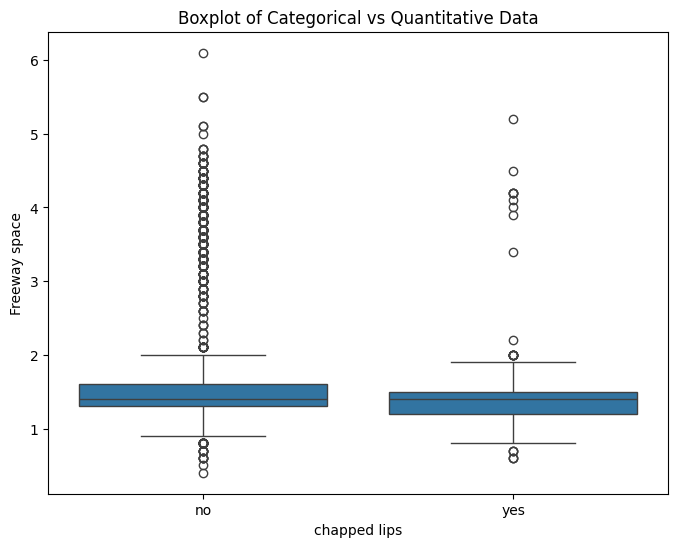

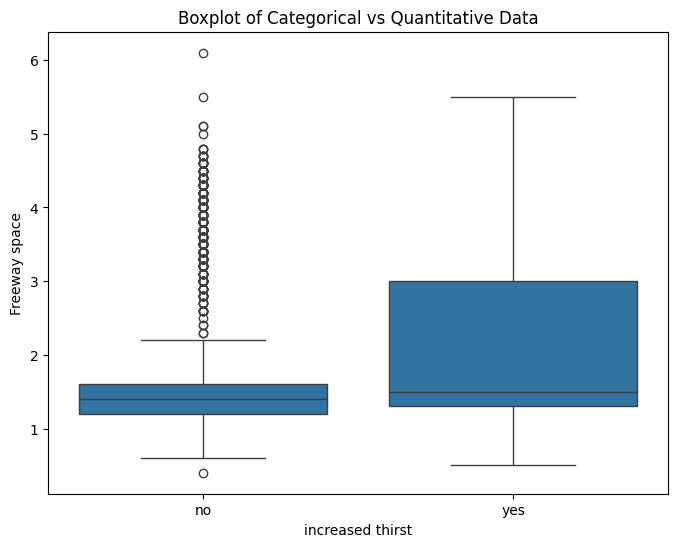

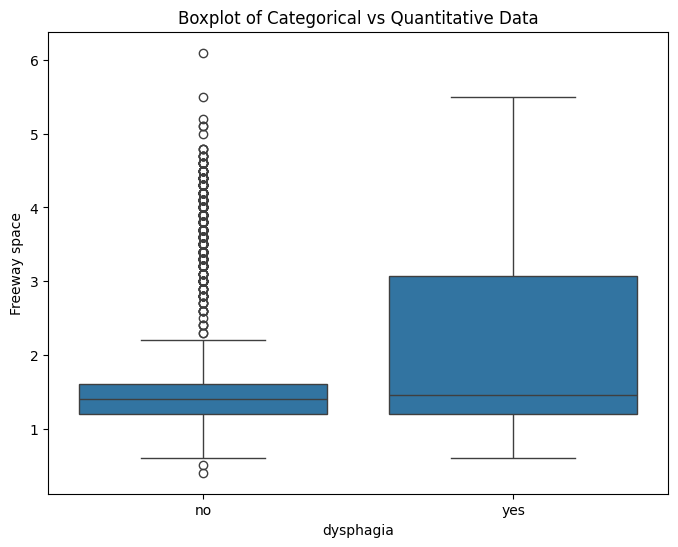

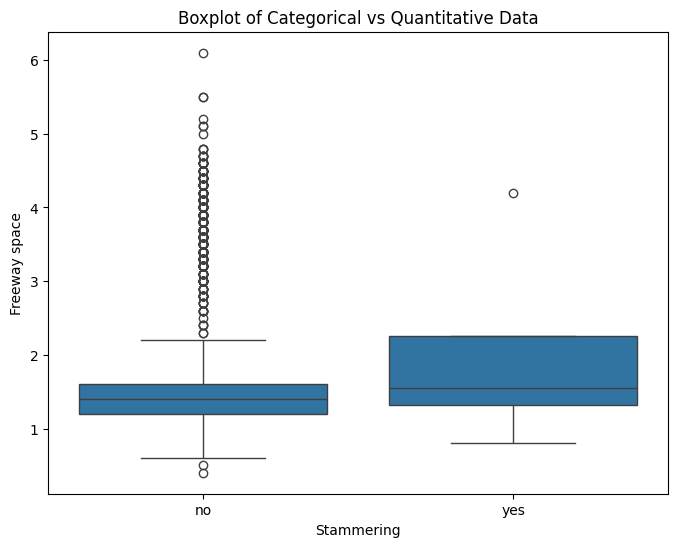

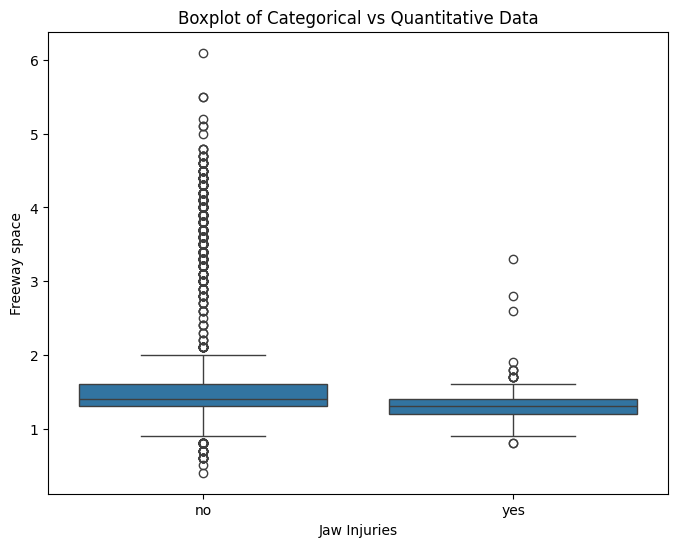

In [202]:
for i, column in enumerate(columns_to_analyze):
    # Create a boxplot
    plt.figure(figsize=(8, 6))
    sns.boxplot(x=full_data[column],
                y=full_data["Freeway space"])

    # Add labels and title
    plt.xlabel(column)
    plt.ylabel("Freeway space")
    plt.title('Boxplot of Categorical vs Quantitative Data')

    plt.savefig(f"boxplot_{i+1}.jpg", dpi=300)
    # Show the plot
    plt.show()
    plt.close()

Drop all of the variables above apart from Dysphagia

In [203]:
columns_to_drop = ["nail or object biting",
                      "chapped lips",
                      "increased thirst",
                      "Stammering",
                      "Jaw Injuries"]
synthetic_data.drop(columns=columns_to_drop,
                    inplace=True)
combined_dataset.drop(columns=columns_to_drop,
                      inplace=True)
full_data = pd.concat([synthetic_data,
                       combined_dataset],
                       axis=0)

In [204]:
for col in synthetic_data.columns:
    print(col)

Ethnicity
Gender
BMI
Clicking
Lockout
Jaw pain (in last 2 years)
Jaw clenching
Bruxism
Sleep apnoea/snoring
Dry/ sticky mouth
dysphagia
Dental filling in 2 years
RCTs/crowns in 2 years
3rd molars extracted
Orthodontic treatment
blocked nose
Lisp
Vit D deficiency
Recurrent sinus infections
Asthma
Endocrine modifiers (Diabetes, PCOS, Ca Breast)
Hypertension or high cholesterol
Inflammatory disorders (arthritis or eczyma)
Mental health modifiers (stress, depression, anxiety, ADHD)
Long term medication taken for condition
Sinus surgery (adenoid or septal)
Canine-canine mandible
Head tilting direction
Soft tissue Lateral left
Soft tissue Lateral right
chewing left side protrusion
chewing left side Lateral left
chewing normal side vertical
JVA MMO left Integral >300Hz
JVA MMO left peak frequency
JVA MLE left integral
JVA MLE right integral
JVA MLE right peak amplitude
JVA MLE right median frequency
JVA MAP left peak frequency
JVA MAP right peak amplitude
Fricative vertical
Fricative Lateral 

#### Quantitative data to drop

In [205]:
numeric_columns_to_analyze = [
    "ROM vertical",
    "chewing normal side vertical",
    "chewing normal  protrusion",
    "chewing normal side Lateral left",
    "chewing normal side Lateral right",
]

sp_coefficients = []
for i, column in enumerate(numeric_columns_to_analyze):
    plt.figure(figsize=(8, 6))
    plt.scatter(x=full_data[column],
                y=full_data["Freeway space"])

    # Add labels and title
    plt.xlabel(column)
    plt.ylabel("Freeway space")

    plt.savefig(f"scatter_{i+1}.jpg",
                dpi=300)

    # Show the plot
    plt.show()
    plt.close()

    x = full_data[column].copy()
    y = full_data['Freeway space'].copy()

    # Calculate Spearman rank correlation coefficient
    spearman_coefficient, p_value = \
        scipy.stats.spearmanr(x, y)
    sp_coefficients.append(spearman_coefficient)
    print(f"Corr coef: {spearman_coefficient}")

KeyError: 'ROM vertical'

<Figure size 800x600 with 0 Axes>

The plots and the Spearman correlation coefficients show that these variables have little to no significant effect on the response variable. Hence, these variables will be dropped.

In [115]:
synthetic_data.drop(columns=numeric_columns_to_analyze,
                    inplace=True)
combined_dataset.drop(columns=numeric_columns_to_analyze,
                      inplace=True)
full_data = pd.concat([synthetic_data,
                       combined_dataset],
                       axis=0)

#### Analyzing intensity and duration coefficients

In [116]:
n_columns = synthetic_data.shape[1]
quotient_columns = synthetic_data.iloc[:,n_columns-36:].columns
print(quotient_columns)

Index(['mmo_intensity_ta_r', 'mmo_intensity_ta_l', 'mmo_intensity_mm_r',
       'mmo_intensity_mm_l', 'mmo_intensity_da_r', 'mmo_intensity_da_l',
       'mmo_duration_ta_r', 'mmo_duration_ta_l', 'mmo_duration_mm_r',
       'mmo_duration_mm_l', 'mmo_duration_da_r', 'mmo_duration_da_l',
       'mle_intensity_ta_r', 'mle_intensity_ta_l', 'mle_intensity_mm_r',
       'mle_intensity_mm_l', 'mle_intensity_da_r', 'mle_intensity_da_l',
       'mle_duration_ta_r', 'mle_duration_ta_l', 'mle_duration_mm_r',
       'mle_duration_mm_l', 'mle_duration_da_r', 'mle_duration_da_l',
       'map_intensity_ta_r', 'map_intensity_ta_l', 'map_intensity_mm_r',
       'map_intensity_mm_l', 'map_intensity_da_r', 'map_intensity_da_l',
       'map_duration_ta_r', 'map_duration_ta_l', 'map_duration_mm_r',
       'map_duration_mm_l', 'map_duration_da_r', 'map_duration_da_l'],
      dtype='object')


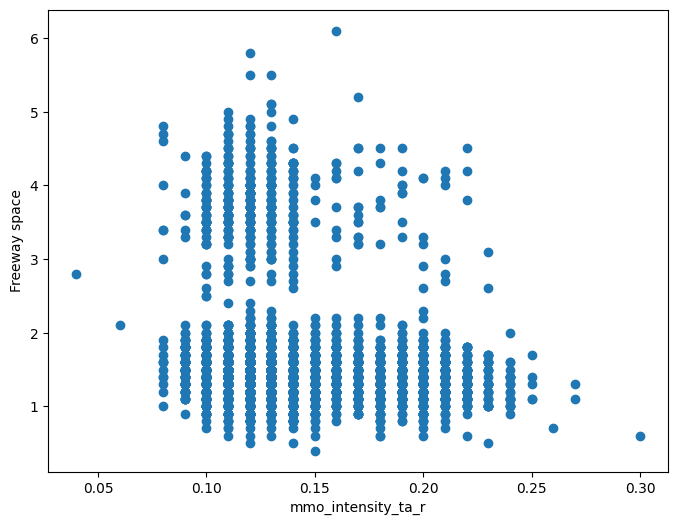

Corr coef: -0.1164961940742833


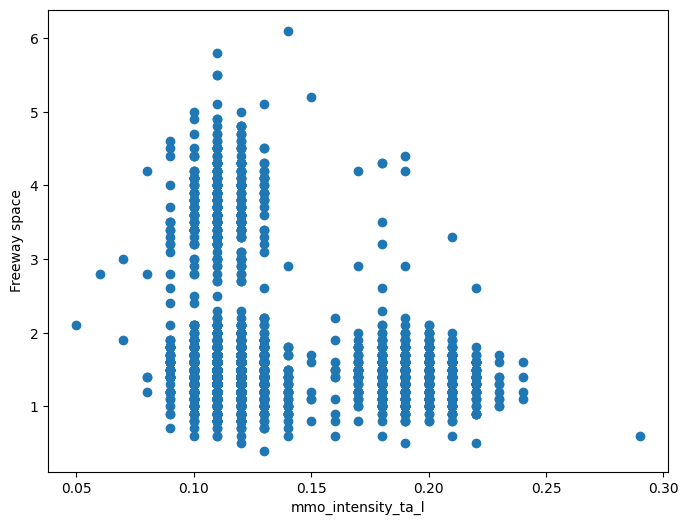

Corr coef: -0.11829715605257218


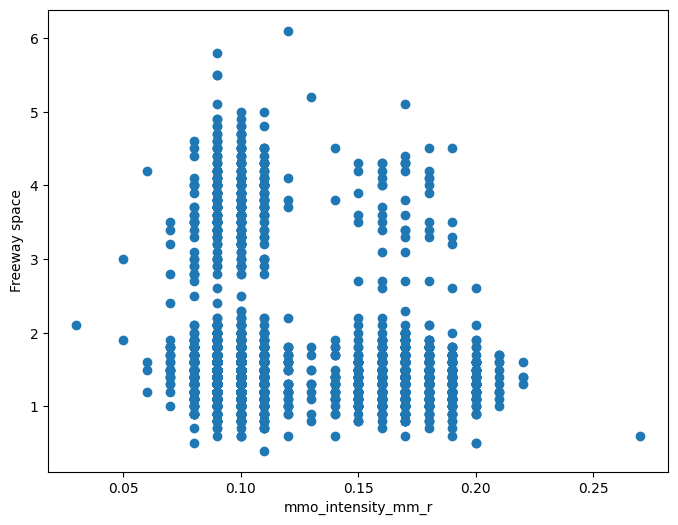

Corr coef: -0.1183340183795702


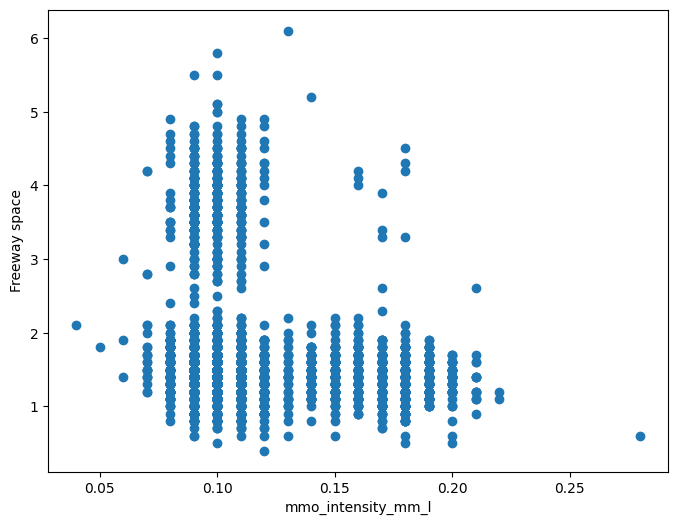

Corr coef: -0.1443368235537168


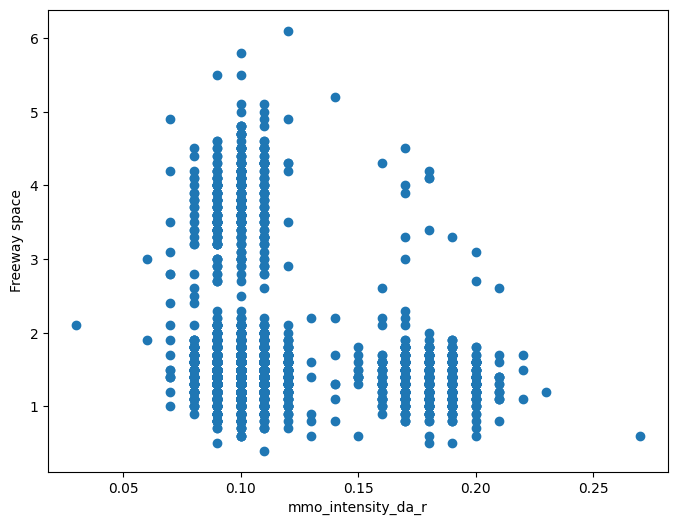

Corr coef: -0.1158397847632668


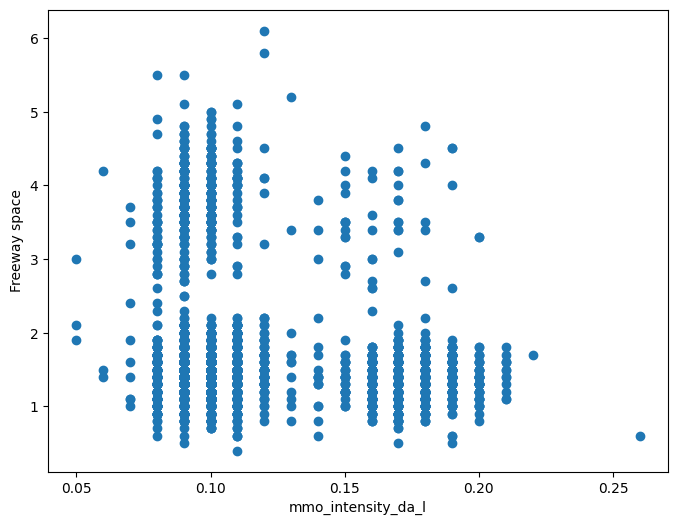

Corr coef: -0.08714045762389307


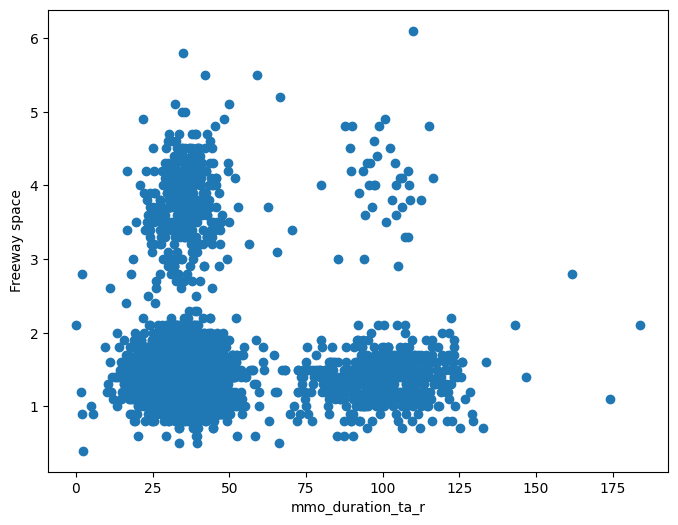

Corr coef: -0.058225731325864165


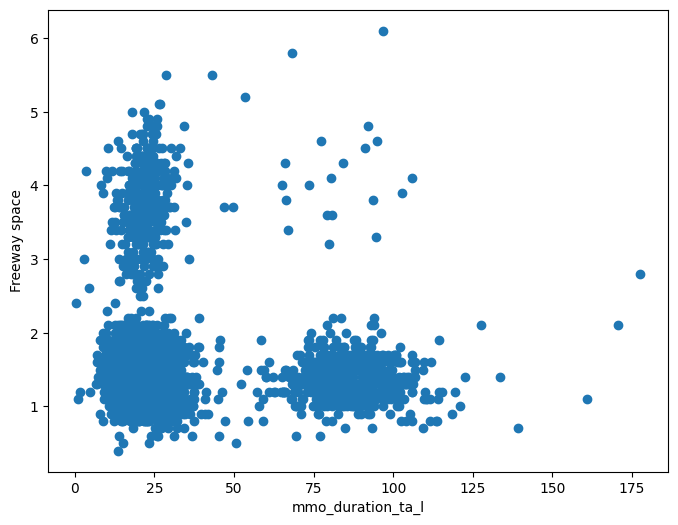

Corr coef: -0.08716504023375062


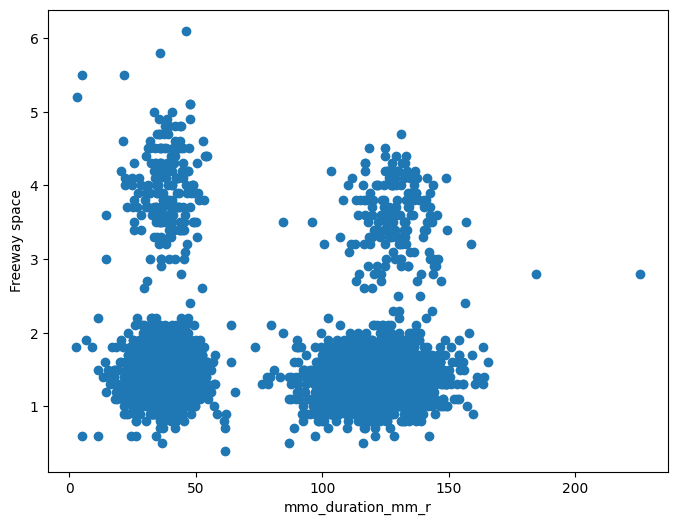

Corr coef: -0.09631756685393383


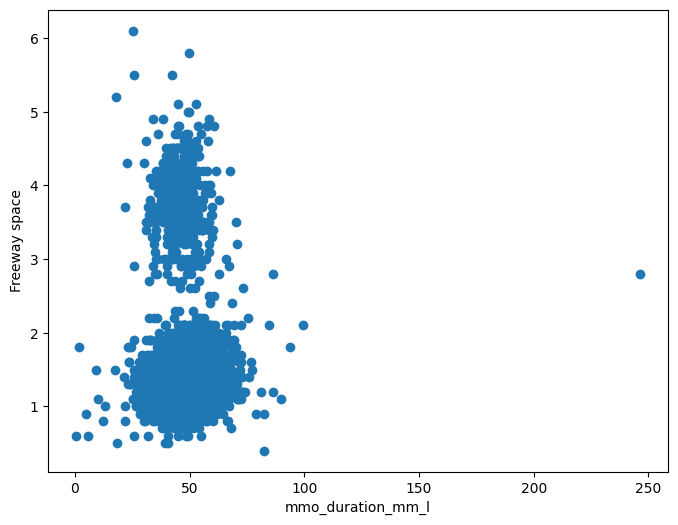

Corr coef: 0.08106409732845926


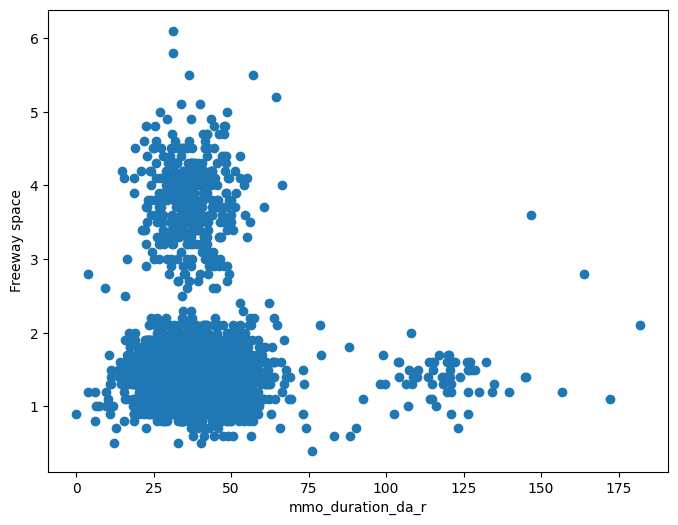

Corr coef: -0.03369903046654588


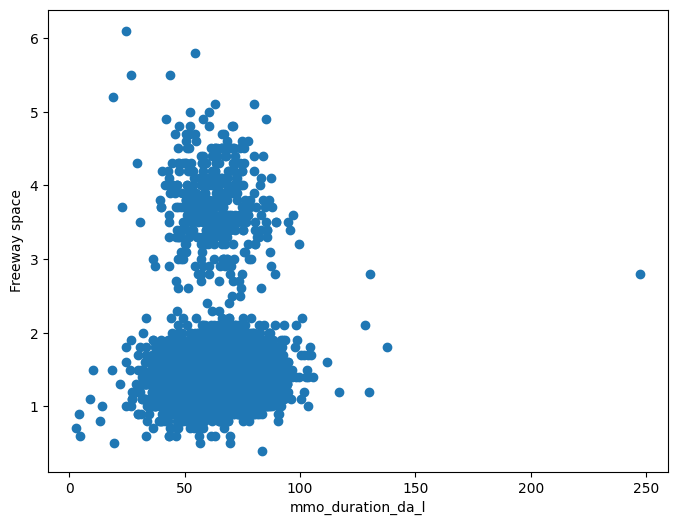

Corr coef: 0.12487230815985617


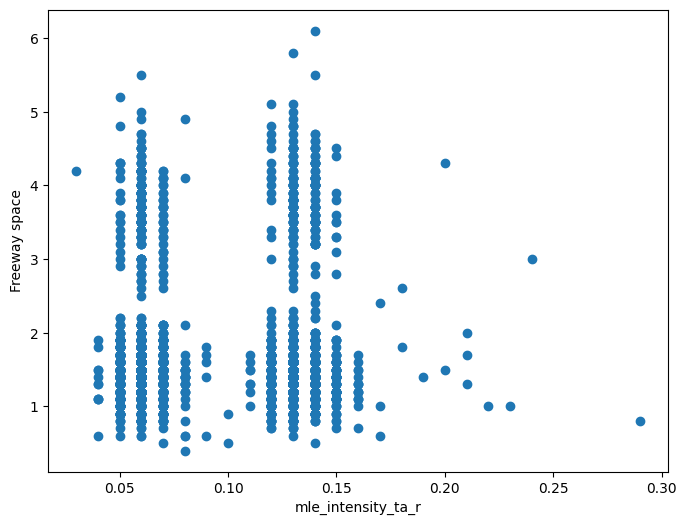

Corr coef: -0.05044047444075694


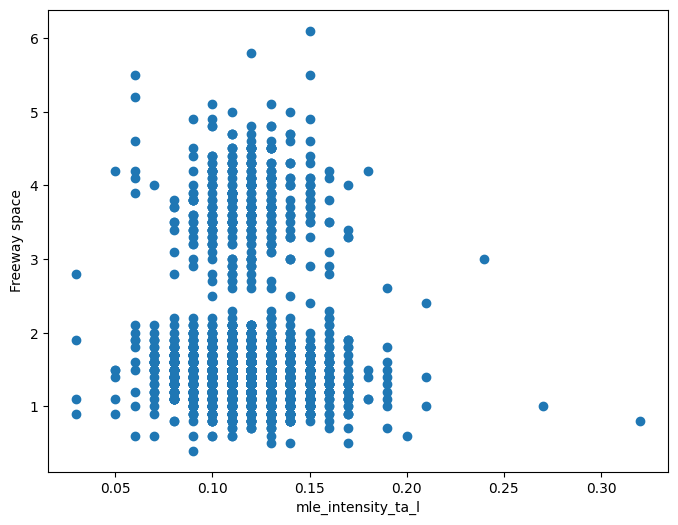

Corr coef: -0.07281830705249982


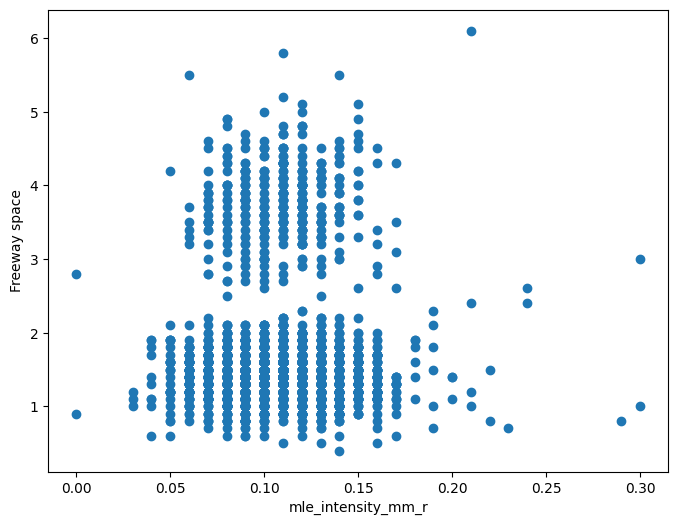

Corr coef: -0.004952290993149121


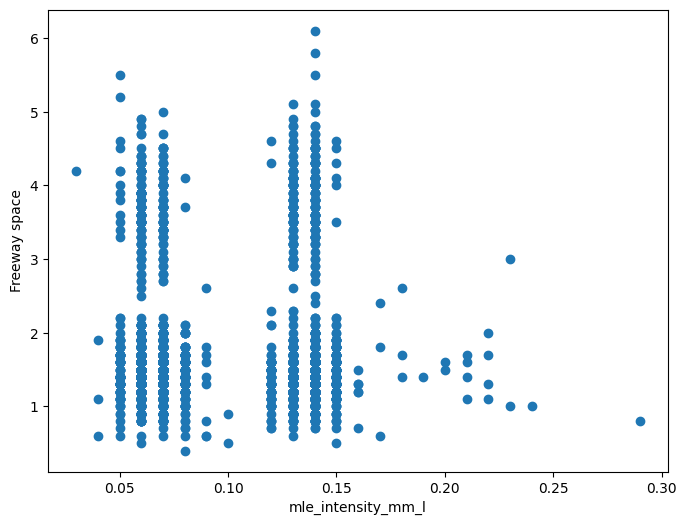

Corr coef: -0.06710565578528066


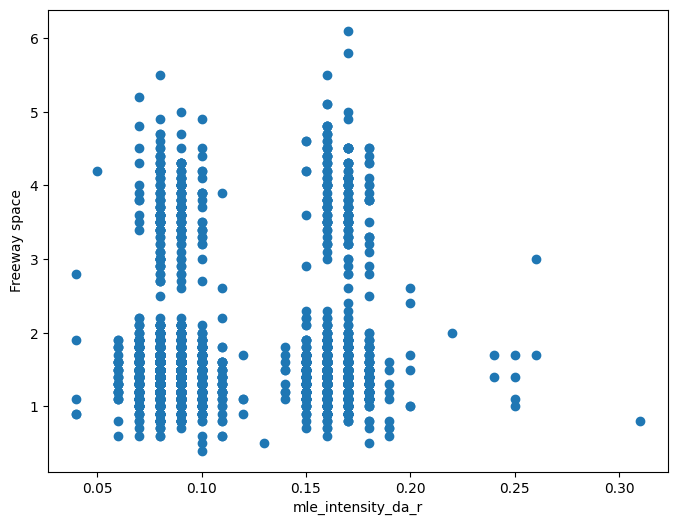

Corr coef: -0.03206024910725925


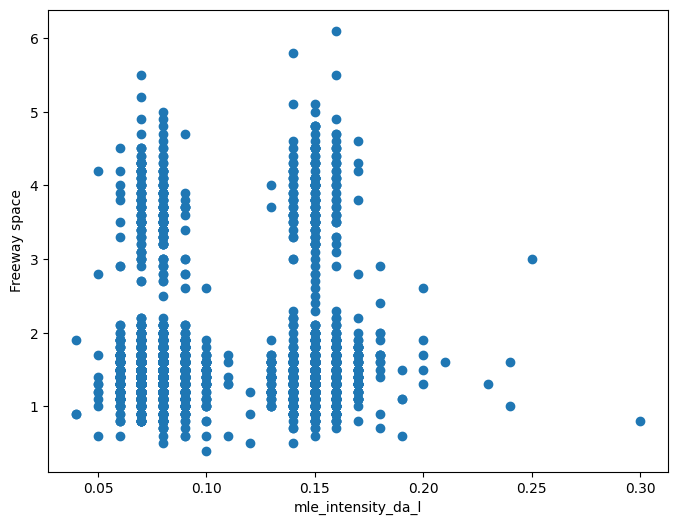

Corr coef: -0.007603244384979902


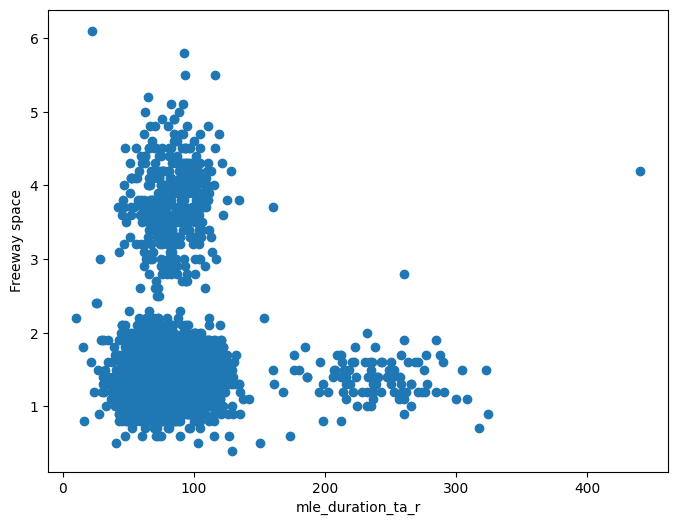

Corr coef: 0.04323836160424368


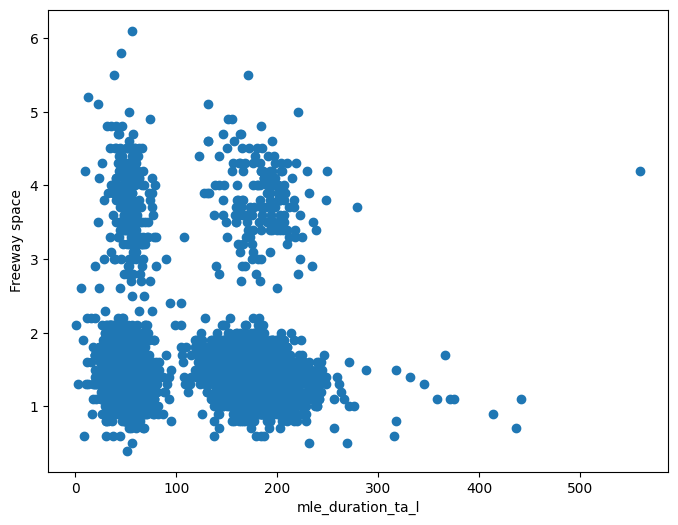

Corr coef: -0.08015993695517591


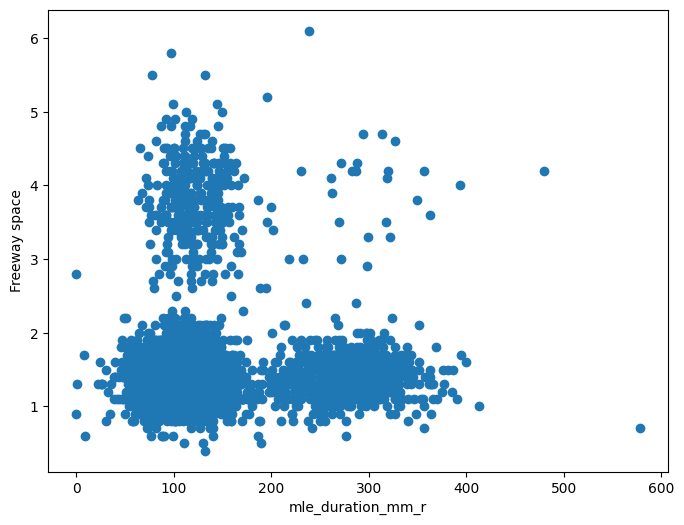

Corr coef: 0.03555053004186348


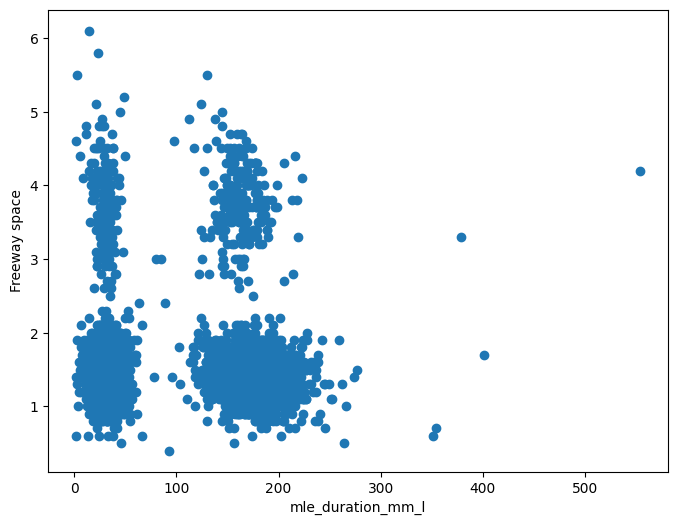

Corr coef: -0.07758157207399259


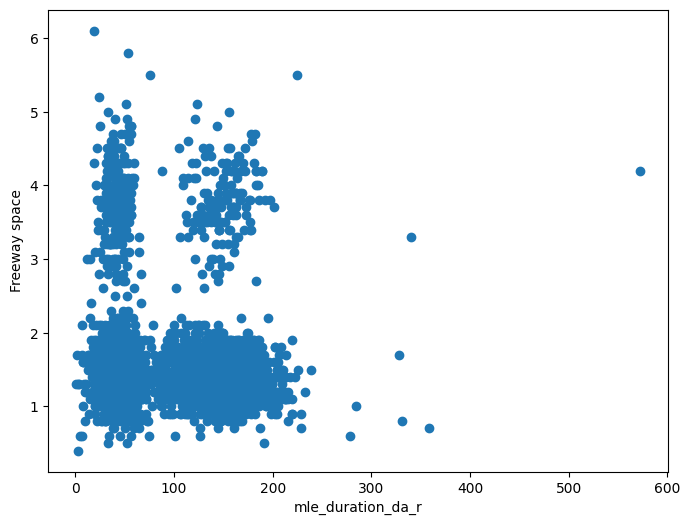

Corr coef: -0.03676030295611148


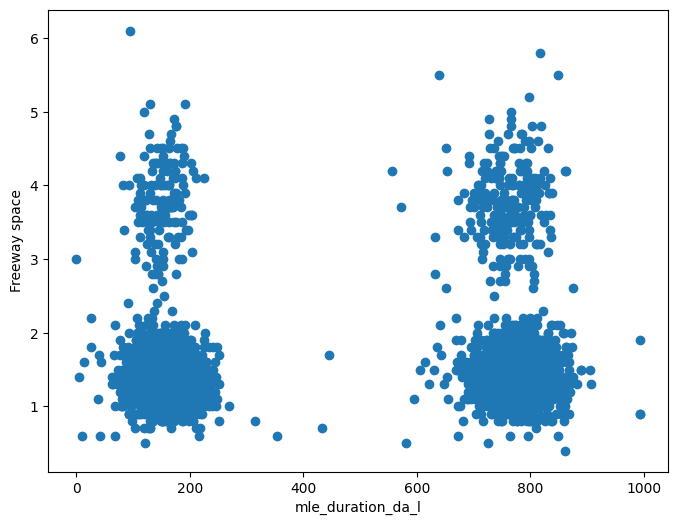

Corr coef: 0.08037199262229223


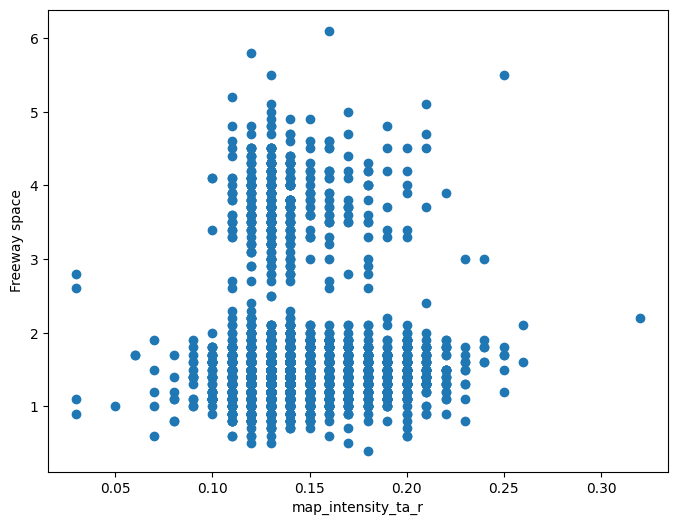

Corr coef: 0.060057826565349505


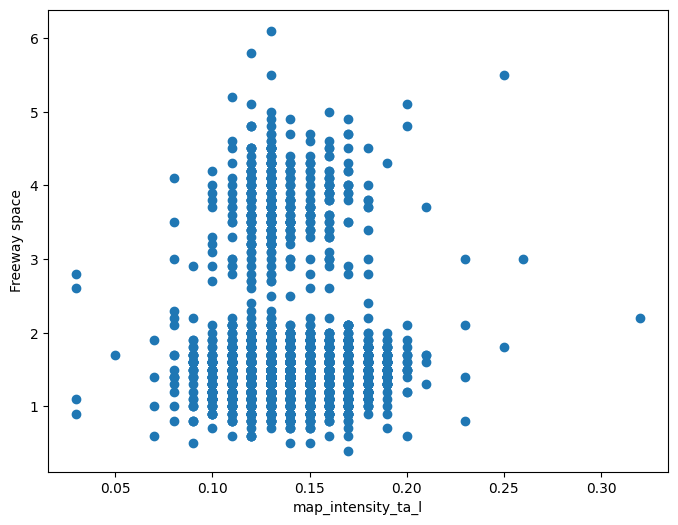

Corr coef: 0.0007985472609615762


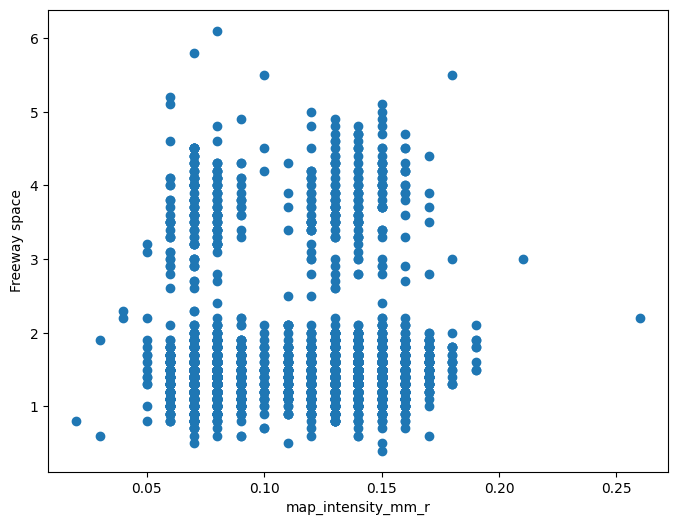

Corr coef: 0.08284364466878939


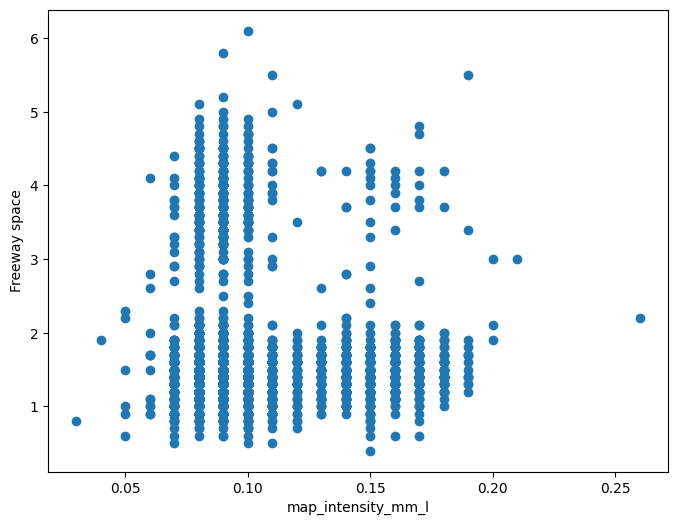

Corr coef: 0.04312846597601906


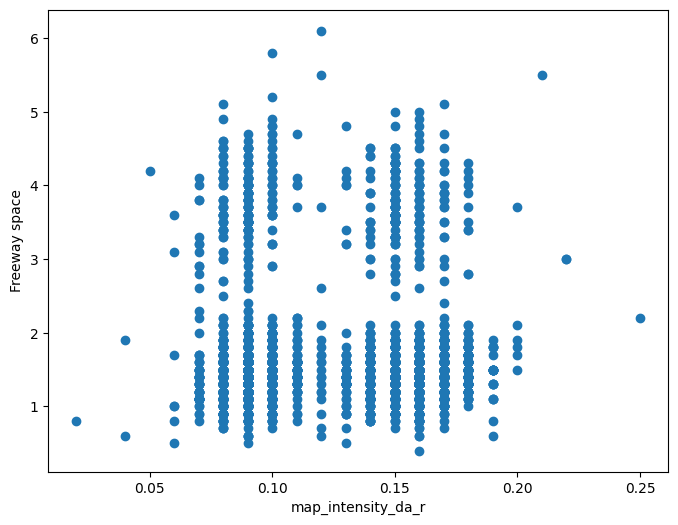

Corr coef: 0.04275895785859687


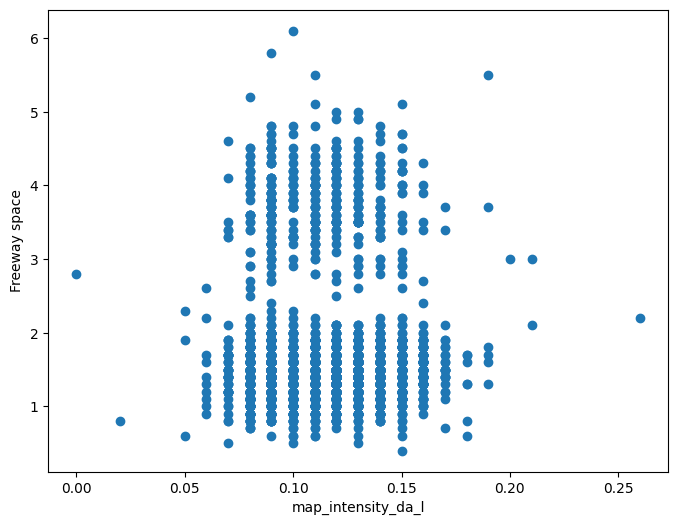

Corr coef: 0.03793378467713563


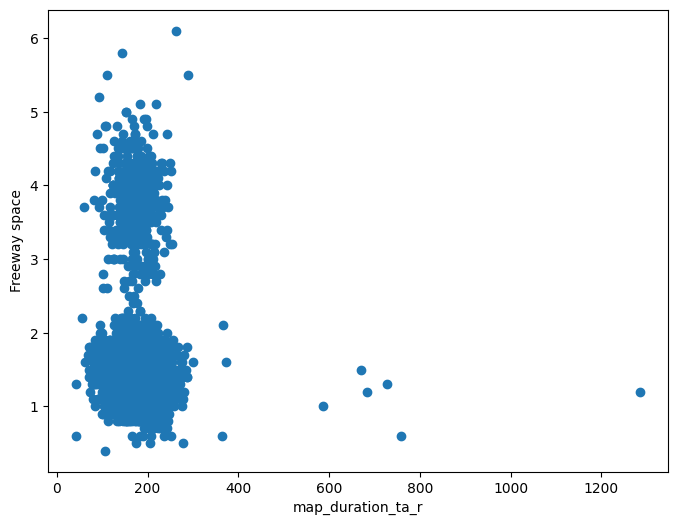

Corr coef: -0.07522557644007584


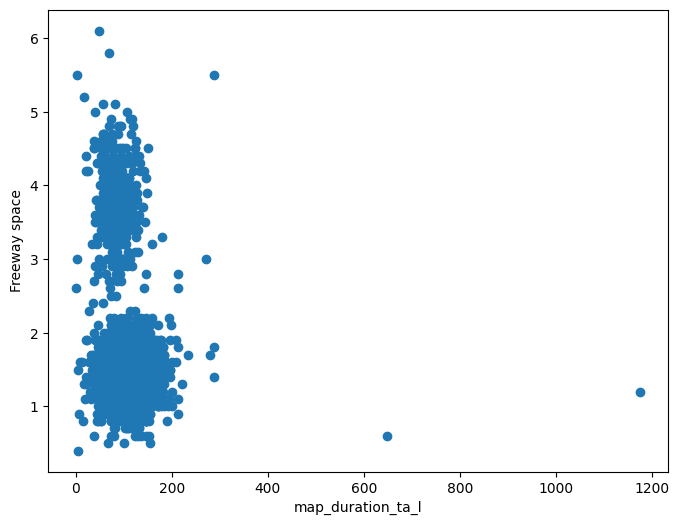

Corr coef: -0.0985856038587272


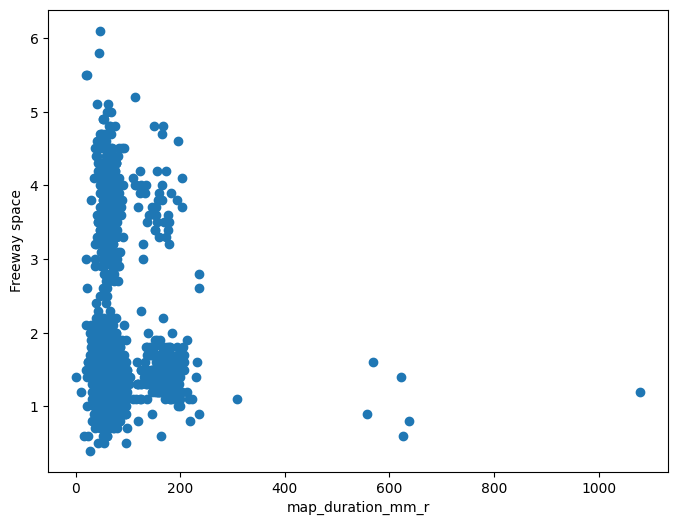

Corr coef: -0.0855577279069315


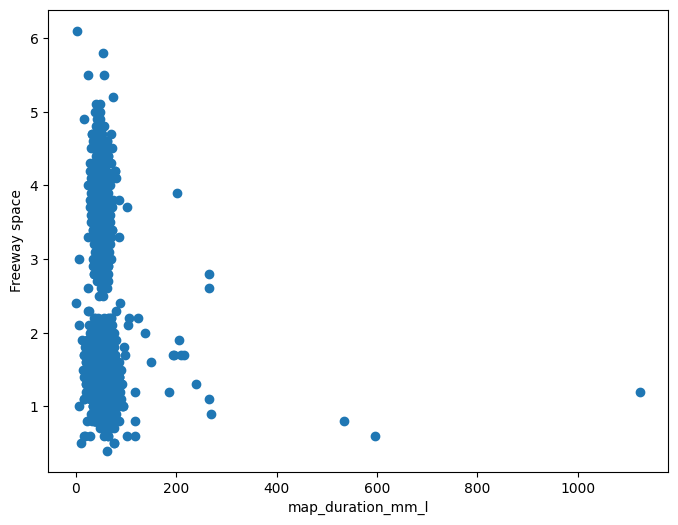

Corr coef: -0.12113814907425287


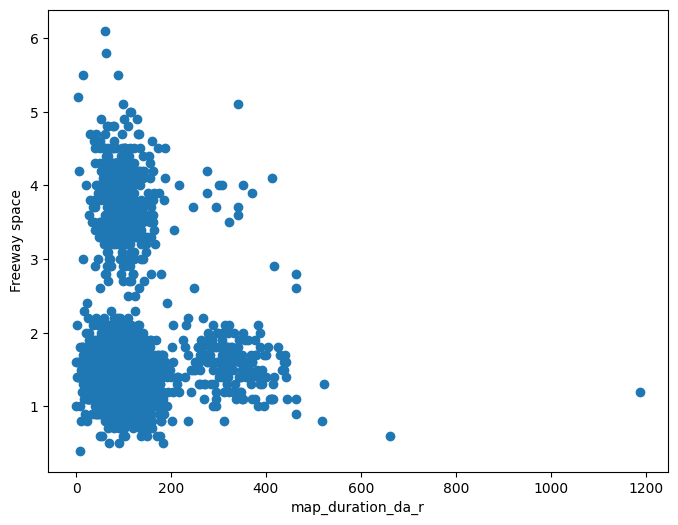

Corr coef: -0.08953107597826512


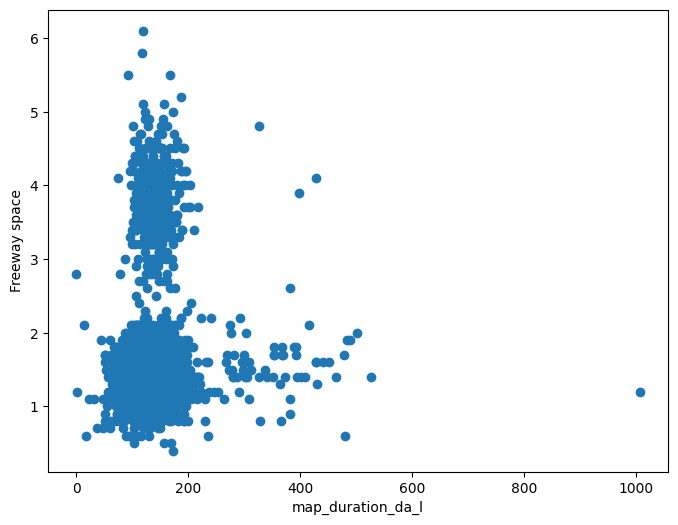

Corr coef: 0.11788202566626654


In [117]:
for column in quotient_columns:
    plt.figure(figsize=(8, 6))
    plt.scatter(x=full_data[column],
                y=full_data["Freeway space"])

    # Add labels and title
    plt.xlabel(column)
    plt.ylabel("Freeway space")

    # Show the plot
    plt.show()

    x = full_data[column].copy()
    y = full_data['Freeway space'].copy()

    # Calculate Spearman rank correlation coefficient
    spearman_coefficient, p_value = \
        scipy.stats.spearmanr(x, y)
    print(f"Corr coef: {spearman_coefficient}")

Once again, all quotients have insignificant influence on the free way space.

In [118]:
synthetic_data.drop(columns=quotient_columns,
                    inplace=True)
combined_dataset.drop(columns=quotient_columns,
                      inplace=True)
full_data = pd.concat([synthetic_data,
                       combined_dataset],
                       axis=0)

In [162]:
# Select a subset of the synthetic data
synthetic_data = synthetic_data.sample(n=2000, random_state=42).copy()

#### Modelling

**Preprocessing**

In [165]:
# Obtain predictor and response variables
y_train = synthetic_data["Freeway space"].copy()
y_test = combined_dataset["Freeway space"].copy()
X_train = synthetic_data.drop(columns=["Freeway space"])
X_test = combined_dataset.drop(columns=["Freeway space"])

# Separating the categorical and continuous variables
train_categorical = X_train.select_dtypes(include='object').copy()
test_categorical = X_test.select_dtypes(include='object').copy()
train_numeric = X_train.drop(columns=train_categorical.columns).copy()
test_numeric = X_test.drop(columns=test_categorical.columns).copy()

# Scaling the numeric data
scaler = StandardScaler()
train_numeric_scaled = scaler.fit_transform(train_numeric)
test_numeric_scaled = scaler.transform(test_numeric)

# One hot encoding the categorical data
train_categorical_encoded = pd.get_dummies(
    train_categorical, dtype=int
)
test_categorical_encoded = pd.get_dummies(
    test_categorical, dtype=int
)

# Combining to form final dataset
X_train_final = np.concatenate([train_numeric_scaled,
                                train_categorical_encoded],
                                axis=1)
X_test_final = np.concatenate([test_numeric_scaled,
                               test_categorical_encoded],
                               axis=1)

# Create a separate set of data for CatBoost
X_train_cb = np.concatenate([train_numeric_scaled,
                             train_categorical.values],
                             axis=1)
X_test_cb = np.concatenate([test_numeric_scaled,
                            test_categorical.values],
                            axis=1)

In [166]:
def get_lr_results(X_train, y_train):
    scores_lr = []
    # Create a CV instance
    cv_lr = KFold(n_splits=5, shuffle=True, random_state=42)
    for train, val in cv_lr.split(X_train, y_train):
        X_train_temp = X_train[train]
        X_val_temp = X_train[val]
        y_train_temp = y_train.values[train]
        y_val_temp = y_train.values[val]

        # Define model
        lr_model = LinearRegression()
        lr_model.fit(X_train_temp, y_train_temp)

        # Predictions
        predictions_train = lr_model.predict(X_train_temp)
        predictions_val = lr_model.predict(X_val_temp)

        train_rmse = np.sqrt(mean_squared_error(y_train_temp,
                                                predictions_train))
        val_rmse = np.sqrt(mean_squared_error(y_val_temp,
                                            predictions_val))
        scores_lr.append((val_rmse, train_rmse))

    # Compute average scores
    avg_val_rmse_lr = np.sum([each[0]
                             for each in scores_lr]) / len(scores_lr)
    avg_train_rmse_lr = np.sum([each[1]
                               for each in scores_lr]) / len(scores_lr)
    
    # Final fitted model
    final_lr = LinearRegression()
    final_lr.fit(X_train, y_train)

    return ((avg_train_rmse_lr,
             avg_val_rmse_lr),
             final_lr)

In [177]:
"""
The following function was taken from
https://xgboost.readthedocs.io/en/stable/python/sklearn_estimator.html
"""
def fit_and_score(estimator, X_train, X_test, y_train, y_test):
    """Fit the estimator on the train set and score it on both sets"""
    estimator.fit(X_train, y_train,
                  eval_set=[(X_test, y_test)], verbose=False)
    predictions_train = estimator.predict(X_train)
    predictions_test = estimator.predict(X_test)
    train_score = mean_absolute_error(y_train,
                                      predictions_train)
    test_score = mean_absolute_error(y_test,
                                     predictions_test)
    return estimator, train_score, test_score

def get_catboost_results(X_train, y_train,
                         categorical_indices):
    model = CatBoostRegressor(early_stopping_rounds=10,
                              cat_features=categorical_indices,
                              loss_function='MAE')
    params = {
        'depth':range(3,6,2),
        'iterations':[100,500,1000],
        'learning_rate':[0.001,0.01,0.03,0.1], 
        'l2_leaf_reg': [1, 3, 5, 7],
        'subsample': [0.6, 0.8, 1.0]
    }
    results = model.grid_search(params,
                                X=X_train,
                                y=y_train,
                                cv=5,
                                refit=True,
                                partition_random_seed=42)
    
    # Refit using best params to create best model
    best_params = results["params"]
    best_params["early_stopping_rounds"] = None
    best_model = CatBoostRegressor(**best_params,
                                   cat_features=categorical_indices)
    best_model.fit(X_train, y_train)

    # Get training and validation scores
    best_train_score = min(results['cv_results']['train-MAE-mean'])
    best_val_score = min(results['cv_results']['test-MAE-mean'])

    scores = {
        "Best Train MAE": best_train_score,
        "Best Validation MAE": best_val_score,
    }
    return scores, best_model

In [178]:
def get_xgboost_results(X_train, y_train):
    # Parameters to tune in the grid
    params_to_test = {
        'max_depth': range(3,10,2),
        'min_child_weight': range(1,6,2),
        'n_estimators': [1000],
        'learning_rate': [0.001],
        'reg_alpha': [0,1,2]
    }

    # Performing gridSearch manually
    best_xgb_scores = None
    best_xgb_model = None
    curr_val_score = float('inf')
    for depth in params_to_test['max_depth']:
        for weight in params_to_test['min_child_weight']:
            for lr in params_to_test['learning_rate']:
                for estimator_count in params_to_test['n_estimators']:
                    for alpha in params_to_test['reg_alpha']:
                        # Create a CV instance
                        cv = KFold(n_splits=5, shuffle=True, random_state=42)

                        # XGBoost model
                        xgb_model = XGBRegressor(n_estimators=estimator_count, max_depth=depth,
                                                min_child_weight=weight, early_stopping_rounds=10,
                                                learning_rate=lr, reg_alpha=alpha)
                        # curr_params = xgb_model.get_params()
                        # curr_params["tree_method"] = 'hist'
                        # curr_params["device"] = 'cuda'
                        # curr_params[""]
                        # xgb_model.set_params(**curr_params)

                        # Add cross validation results
                        total_train_score = 0
                        total_val_score = 0
                        for train, val in cv.split(X_train, y_train):
                            X_train_temp = X_train[train]
                            X_val_temp = X_train[val]
                            y_train_temp = y_train.values[train]
                            y_val_temp = y_train.values[val]

                            # # Transfer data to GPU
                            # X_train_temp_gpu = \
                            #     torch.tensor(X_train_temp).to('cuda:0')
                            # X_val_temp_gpu = \
                            #     torch.tensor(X_val_temp).to('cuda:0')
                            # y_train_temp_gpu = \
                            #     torch.tensor(y_train_temp).to('cuda:0')
                            # y_val_temp_gpu = \
                            #     torch.tensor(y_val_temp).to('cuda:0')

                            est, train_score, test_score = fit_and_score(
                                clone(xgb_model), X_train_temp,
                                X_val_temp, y_train_temp,
                                y_val_temp
                            )
                            total_train_score += train_score
                            total_val_score += test_score

                            avg_val_score = total_val_score / 5
                            if avg_val_score < curr_val_score:
                                curr_val_score = avg_val_score
                                best_xgb_scores = (total_train_score / 5, avg_val_score)
                                best_xgb_model = est
                                print(total_train_score / 5,
                                      avg_val_score)

    # Determine best model (refitted)
    best_params = best_xgb_model.get_params()
    best_params["early_stopping_rounds"] = None
    best_model = XGBRegressor(**best_params)
    best_model.fit(X_train, y_train)
    return best_xgb_scores, best_model


In [169]:
def get_rf_results(X_train, y_train):
    params_to_test = {
        'max_depth': range(3,10,2),
        'n_estimators': [100, 500, 1000],
        'max_features': [1.0, 'sqrt', 'log2']
    }
    rf_grid = GridSearchCV(RandomForestRegressor(random_state=42),
                           params_to_test, cv=5,
                           scoring='neg_mean_squared_error',
                           return_train_score=True)

    # Best scores
    rf_grid.fit(X_train, y_train)
    rf_train_score = np.sqrt(
        -rf_grid.cv_results_['mean_train_score'][rf_grid.best_index_])
    rf_val_score = np.sqrt(-rf_grid.best_score_)

    # Best params
    best_params = rf_grid.best_params_
    best_model = RandomForestRegressor(**best_params)
    best_model.fit(X_train, y_train)

    return (rf_train_score, rf_val_score), best_model

In [170]:
def get_mlp_results(X_train, y_train):
    model = models.Sequential()
    model.add(layers.Dense(100, activation='relu', input_shape=(X_train.shape[1],)))
    model.add(layers.Dense(500, activation='relu'))
    model.add(layers.Dense(200, activation='relu'))
    model.add(layers.Dense(100, activation='relu'))
    model.add(layers.Dense(1)) # now using Sigmoid

    # We define a Callback
    callback = keras.callbacks.EarlyStopping(patience=50, monitor='loss')
    model.compile(loss='mean_squared_error',
                  optimizer='adam',
                  metrics=keras.metrics.RootMeanSquaredError(name='rmse'))

    history = model.fit(X_train, y_train,
                        validation_split=0.20,
                        batch_size=min([200, X_train.shape[0]]),
                        epochs=1000, callbacks=[callback])
    
    min_loss = float('inf')
    best_epoch = -1
    for i, each in enumerate(history.history["val_loss"]):
        if each < min_loss:
            min_loss = each
            best_epoch = i

    best_score = history.history["val_rmse"][best_epoch]
    best_loss = history.history["val_loss"][best_epoch]

    return (best_loss, best_score), model

In [171]:
def get_tabnet_results(X_train, y_train):
    # Create a CV instance
    reduced_X_train, X_val, reduced_y_train, y_val = \
        train_test_split(X_train, y_train, train_size=0.80)
    
    model = TabNetRegressor()
    model.fit(reduced_X_train,
              reduced_y_train,
              eval_metric=["rmse"],
              eval_set=[(X_val, y_val)],
              max_epochs=1000,
              patience=100)
    best_epoch = model.best_epoch
    best_loss = model.history.history['loss'][best_epoch]
    best_rmse = model.history.history['val_0_rmse'][best_epoch]
    return (best_loss, best_rmse), model

In [172]:
# Linear regression
lr_results = get_lr_results(X_train_final, y_train)

In [174]:
mlp_results = get_mlp_results(X_train_final,
                              y_train)

Epoch 1/1000
8/8 [==============================] - 0s 12ms/step - loss: 1.0532 - rmse: 1.0262 - val_loss: 0.8380 - val_rmse: 0.9154
Epoch 2/1000
8/8 [==============================] - 0s 4ms/step - loss: 0.5190 - rmse: 0.7204 - val_loss: 0.5609 - val_rmse: 0.7489
Epoch 3/1000
8/8 [==============================] - 0s 4ms/step - loss: 0.3845 - rmse: 0.6201 - val_loss: 0.4899 - val_rmse: 0.6999
Epoch 4/1000
8/8 [==============================] - 0s 4ms/step - loss: 0.3345 - rmse: 0.5783 - val_loss: 0.4329 - val_rmse: 0.6580
Epoch 5/1000
8/8 [==============================] - 0s 4ms/step - loss: 0.2980 - rmse: 0.5459 - val_loss: 0.4237 - val_rmse: 0.6509
Epoch 6/1000
8/8 [==============================] - 0s 4ms/step - loss: 0.2610 - rmse: 0.5109 - val_loss: 0.4227 - val_rmse: 0.6502
Epoch 7/1000
8/8 [==============================] - 0s 4ms/step - loss: 0.2335 - rmse: 0.4832 - val_loss: 0.3981 - val_rmse: 0.6309
Epoch 8/1000
8/8 [==============================] - 0s 4ms/step - loss: 0.2

In [175]:
# Tabnet results
tabnet_results = get_tabnet_results(X_train_final,
                                    y_train.values.reshape(-1,1))

epoch 0  | loss: 9.84912 | val_0_rmse: 2.1886  |  0:00:00s


/Users/tashrequehaq/miniconda3/lib/python3.11/site-packages/pytorch_tabnet/abstract_model.py:82: UserWarning: Device used : cpu
  warnings.warn(f"Device used : {self.device}")


epoch 1  | loss: 7.90303 | val_0_rmse: 1.93544 |  0:00:00s
epoch 2  | loss: 6.00712 | val_0_rmse: 1.76059 |  0:00:00s
epoch 3  | loss: 4.69085 | val_0_rmse: 1.67399 |  0:00:00s
epoch 4  | loss: 3.85547 | val_0_rmse: 1.60408 |  0:00:00s
epoch 5  | loss: 3.11436 | val_0_rmse: 1.53248 |  0:00:00s
epoch 6  | loss: 2.50484 | val_0_rmse: 1.47668 |  0:00:00s
epoch 7  | loss: 2.08133 | val_0_rmse: 1.41197 |  0:00:00s
epoch 8  | loss: 1.75868 | val_0_rmse: 1.3728  |  0:00:01s
epoch 9  | loss: 1.61526 | val_0_rmse: 1.38855 |  0:00:01s
epoch 10 | loss: 1.40206 | val_0_rmse: 1.22208 |  0:00:01s
epoch 11 | loss: 1.06382 | val_0_rmse: 1.10836 |  0:00:01s
epoch 12 | loss: 0.97846 | val_0_rmse: 1.04019 |  0:00:01s
epoch 13 | loss: 0.90477 | val_0_rmse: 0.98855 |  0:00:01s
epoch 14 | loss: 0.8965  | val_0_rmse: 0.93434 |  0:00:01s
epoch 15 | loss: 0.7431  | val_0_rmse: 0.91434 |  0:00:01s
epoch 16 | loss: 0.77595 | val_0_rmse: 0.89186 |  0:00:02s
epoch 17 | loss: 0.68567 | val_0_rmse: 0.879   |  0:00:0

/Users/tashrequehaq/miniconda3/lib/python3.11/site-packages/pytorch_tabnet/callbacks.py:172: UserWarning: Best weights from best epoch are automatically used!
  warnings.warn(wrn_msg)


In [176]:
# Catboost
cb_results = get_catboost_results(X_train_cb,
                                  y_train,
                                  categorical_indices=list(range(98,123)))

0:	learn: 1.6052961	test: 1.5578005	best: 1.5578005 (0)	total: 3.83ms	remaining: 379ms
1:	learn: 1.6038454	test: 1.5563497	best: 1.5563497 (1)	total: 7.67ms	remaining: 376ms
2:	learn: 1.6023822	test: 1.5548876	best: 1.5548876 (2)	total: 9.3ms	remaining: 301ms
3:	learn: 1.6009147	test: 1.5534248	best: 1.5534248 (3)	total: 11.5ms	remaining: 275ms
4:	learn: 1.5994548	test: 1.5519634	best: 1.5519634 (4)	total: 12.7ms	remaining: 241ms
5:	learn: 1.5980222	test: 1.5505329	best: 1.5505329 (5)	total: 13.7ms	remaining: 215ms
6:	learn: 1.5966079	test: 1.5491217	best: 1.5491217 (6)	total: 14.6ms	remaining: 193ms
7:	learn: 1.5951517	test: 1.5476707	best: 1.5476707 (7)	total: 15.8ms	remaining: 182ms
8:	learn: 1.5936827	test: 1.5462009	best: 1.5462009 (8)	total: 17.4ms	remaining: 176ms
9:	learn: 1.5922826	test: 1.5447985	best: 1.5447985 (9)	total: 20.1ms	remaining: 181ms
10:	learn: 1.5908380	test: 1.5433540	best: 1.5433540 (10)	total: 22.7ms	remaining: 184ms
11:	learn: 1.5894299	test: 1.5419450	best:

In [181]:
# XGBoost results
xgb_results = get_xgboost_results(X_train_final,
                                  y_train)

0.07251737788021564 0.0698914110660553
0.07266709311902522 0.06946931688785554
0.07290416498780253 0.06913821324110032
0.0728970940232277 0.06912953760623933
0.07292004229724407 0.06900201144218446
0.06311975512206555 0.06727866116762161
0.06357914764583111 0.06654242565631867
0.054165641331672676 0.06579538034200669
0.050107056817412364 0.06460237679481505


/Users/tashrequehaq/miniconda3/lib/python3.11/site-packages/xgboost/data.py:520: FutureWarning: is_sparse is deprecated and will be removed in a future version. Check `isinstance(dtype, pd.SparseDtype)` instead.
  if is_sparse(data):


In [182]:
xgb_results

((0.050107056817412364, 0.06460237679481505),
 XGBRegressor(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.001, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=9, max_leaves=None,
              min_child_weight=1, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=1000, n_jobs=None,
              num_parallel_tree=None, random_state=None, ...))

In [180]:
mean_absolute_error(y_test,
                    cb_results[1].predict(X_test_cb))

0.7554620358998536

In [186]:
mean_absolute_error(y_test,
                    xgb_results[1].predict(X_test_final))

0.8826748044674213

#### Discarding features based on importance

In [140]:
all_column_names = list(train_numeric.columns) + \
    list(train_categorical.columns)

In [141]:
# Catboost feature importances
importances_cb = cb_results[1].get_feature_importance(type="FeatureImportance")

# Create a DataFrame for better visualization
feature_importance_df = pd.DataFrame({'Feature': all_column_names,
                                      'Importance': importances_cb})

# Sort the DataFrame by importance in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance',
                                                          ascending=False)

In [142]:
with pd.option_context('display.max_rows',
                       None, 'display.max_columns',
                       None):  # more options can be specified also
    print(feature_importance_df)

                                               Feature  Importance
100                                           Clicking    4.008281
62                        JVA MLE right peak frequency    3.749063
87                             TH phonetics protrusion    3.467162
24                         chewing right side vertical    3.071735
48                        JVA MMO right peak frequency    2.932918
101                                            Lockout    2.805775
55                         JVA MLE left peak frequency    2.505049
1                                          Height (cm)    2.364251
69                         JVA MAP left peak frequency    2.302566
16                                           ROM Slant    2.112872
85                              Sibilant Lateral right    2.101566
67                         JVA MAP left Integral ratio    2.080711
64                               JVA MAP left integral    2.050946
119  Mental health modifiers (stress, depression, a...    2.04

In [143]:
best_features = \
    feature_importance_df[feature_importance_df["Importance"] \
                          >= 0.5]["Feature"]

In [150]:
new_synthetic_data = synthetic_data[
    list(best_features.values) + ["Freeway space"]
].copy()
new_combined_dataset = combined_dataset[
    list(best_features.values) + ["Freeway space"]
].copy()

In [152]:
# Form data again
# Obtain predictor and response variables
y_train_new = new_synthetic_data["Freeway space"].copy()
y_test_new = new_combined_dataset["Freeway space"].copy()
X_train_new = new_synthetic_data.drop(columns=["Freeway space"])
X_test_new = new_combined_dataset.drop(columns=["Freeway space"])

# Separating the categorical and continuous variables
train_categorical_new = X_train_new.select_dtypes(include='object').copy()
test_categorical_new = X_test_new.select_dtypes(include='object').copy()
train_numeric_new = X_train_new.drop(columns=train_categorical_new.columns).copy()
test_numeric_new = X_test_new.drop(columns=test_categorical_new.columns).copy()

# Scaling the numeric data
scaler = StandardScaler()
train_numeric_scaled_new = scaler.fit_transform(train_numeric_new)
test_numeric_scaled_new = scaler.transform(test_numeric_new)

# One hot encoding the categorical data
train_categorical_encoded_new = pd.get_dummies(
    train_categorical_new, dtype=int
)
test_categorical_encoded_new = pd.get_dummies(
    test_categorical_new, dtype=int
)

# Combining to form final dataset
X_train_final_new = np.concatenate([train_numeric_scaled_new,
                                    train_categorical_encoded_new],
                                    axis=1)
X_test_final_new = np.concatenate([test_numeric_scaled_new,
                                   test_categorical_encoded_new],
                                   axis=1)

# Create a separate set of data for CatBoost
X_train_cb_new = np.concatenate([train_numeric_scaled_new,
                                 train_categorical_new.values],
                                 axis=1)
X_test_cb_new = np.concatenate([test_numeric_scaled_new,
                                test_categorical_new.values],
                                axis=1)

In [159]:
# Do Catboost again using best features
# Catboost
cb_results_new = get_catboost_results(X_train_cb_new,
                                      y_train_new,
                                      categorical_indices=list(range(62,71)))

0:	learn: 1.5872597	test: 1.6003834	best: 1.6003834 (0)	total: 3.17ms	remaining: 313ms
1:	learn: 1.5858256	test: 1.5989500	best: 1.5989500 (1)	total: 5.95ms	remaining: 292ms
2:	learn: 1.5844020	test: 1.5975264	best: 1.5975264 (2)	total: 9.84ms	remaining: 318ms
3:	learn: 1.5830015	test: 1.5961259	best: 1.5961259 (3)	total: 12.5ms	remaining: 301ms
4:	learn: 1.5816041	test: 1.5947289	best: 1.5947289 (4)	total: 16.2ms	remaining: 309ms
5:	learn: 1.5801824	test: 1.5933064	best: 1.5933064 (5)	total: 19.1ms	remaining: 299ms
6:	learn: 1.5787438	test: 1.5918704	best: 1.5918704 (6)	total: 22ms	remaining: 292ms
7:	learn: 1.5773294	test: 1.5904583	best: 1.5904583 (7)	total: 25.5ms	remaining: 294ms
8:	learn: 1.5759385	test: 1.5890678	best: 1.5890678 (8)	total: 28.9ms	remaining: 293ms
9:	learn: 1.5745447	test: 1.5876737	best: 1.5876737 (9)	total: 32.2ms	remaining: 290ms
10:	learn: 1.5731219	test: 1.5862534	best: 1.5862534 (10)	total: 35.1ms	remaining: 284ms
11:	learn: 1.5716887	test: 1.5848173	best: 

In [160]:
cb_results_new

({'Best Train MAE': 0.2839022666494514,
  'Best Validation MAE': 0.3173339492087873},
 <catboost.core.CatBoostRegressor at 0x130d5bdd0>)

In [185]:
mean_absolute_error(y_test_new,
                    cb_results_new[1].predict(X_test_cb_new))

0.7077998636741416